#### Walmart-Recruiting-Store-Sales-Forecasting

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import ydata_profiling
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error

import warnings
warnings.filterwarnings('ignore')

In [2]:
# reading the files
df_train = pd.read_csv('train.csv')
df_test = pd.read_csv('test.csv')
df_store = pd.read_csv('stores.csv')
df_feature = pd.read_csv('features.csv')
df_sample_submission = pd.read_csv('sample_submission.csv')

In [3]:
df_train.head()

,Store,Dept,Date,Weekly_Sales,IsHoliday
0,1,1,2010-02-05,24924.50,False
1,1,1,2010-02-12,46039.49,True
2,1,1,2010-02-19,41595.55,False
3,1,1,2010-02-26,19403.54,False
4,1,1,2010-03-05,21827.90,False


In [4]:
df_train.shape

(421570, 5)

In [5]:
df_train.dropna(inplace=True)

In [6]:
df_train.columns

Index(['Store', 'Dept', 'Date', 'Weekly_Sales', 'IsHoliday'], dtype='object')

In [7]:
df_train.isna().sum()

Store           0
Dept            0
Date            0
Weekly_Sales    0
IsHoliday       0
dtype: int64

In [8]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 421570 entries, 0 to 421569
Data columns (total 5 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   Store         421570 non-null  int64  
 1   Dept          421570 non-null  int64  
 2   Date          421570 non-null  object 
 3   Weekly_Sales  421570 non-null  float64
 4   IsHoliday     421570 non-null  bool   
dtypes: bool(1), float64(1), int64(2), object(1)
memory usage: 13.3+ MB


In [9]:
df_train.describe()

,Store,Dept,Weekly_Sales
count,421570.000000,421570.000000,421570.000000
mean,22.200546,44.260317,15981.258123
std,12.785297,30.492054,22711.183519
min,1.000000,1.000000,-4988.940000
25%,11.000000,18.000000,2079.650000
50%,22.000000,37.000000,7612.030000
75%,33.000000,74.000000,20205.852500
max,45.000000,99.000000,693099.360000


In [10]:
duplicated_rows=df_train[df_train.duplicated()]
print(f"No. of Duplicated Rows Present in the dataset: {duplicated_rows}")

No. of Duplicated Rows Present in the dataset: Empty DataFrame
Columns: [Store, Dept, Date, Weekly_Sales, IsHoliday]
Index: []


In [11]:
#Numerical colummns
num_features=[column for column in df_train.columns if df_train[column].dtype != "O"]

In [12]:
num_features.pop()

'IsHoliday'

In [13]:
#categorical features
cat_feature=[feature for feature in df_train.columns if df_train[feature].dtype == 'O']
print(cat_feature)

['Date']


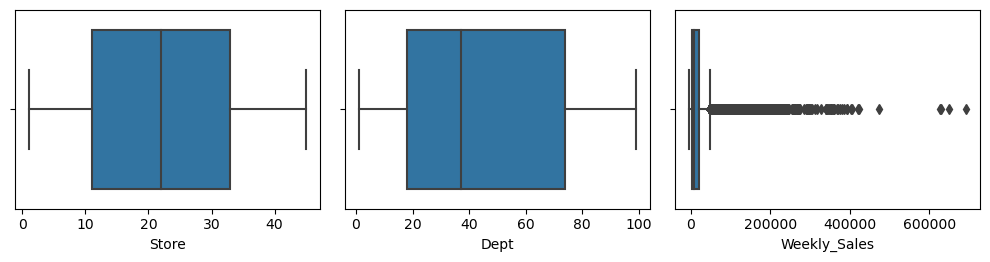

In [14]:
#EDA
fig=plt.figure(figsize=(10,10))

for i in range(len(num_features)):
    plt.subplot(4,3,i+1)
    sns.boxplot(data=df_train, x=df_train[num_features[i]])
    
plt.tight_layout()
plt.show()

There seem to be some outliers in Weekly_sales column

##### Kernal Density estimation of Numerical Columns

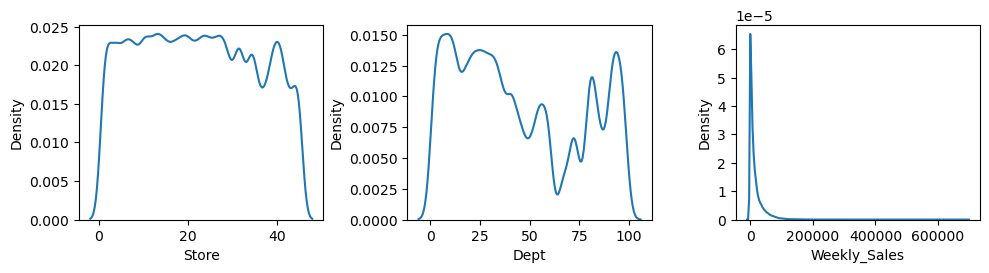

In [15]:
fig = plt.figure(figsize=(10,10))
for i in range(len(num_features)):
    plt.subplot(4,3,i+1)
    sns.kdeplot(data=df_train[num_features[i]])
    
plt.tight_layout()
plt.show()

Conclusion: There seem to be non-normal distributions in numeric columns

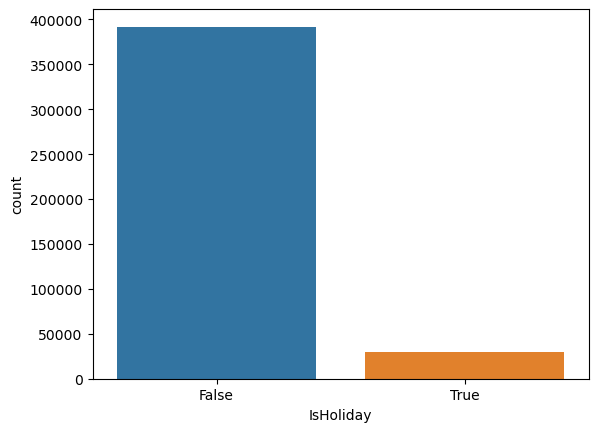

In [16]:
sns.countplot(data=df_train, x="IsHoliday");

In [17]:
df_train["IsHoliday"].value_counts()

False    391909
True      29661
Name: IsHoliday, dtype: int64

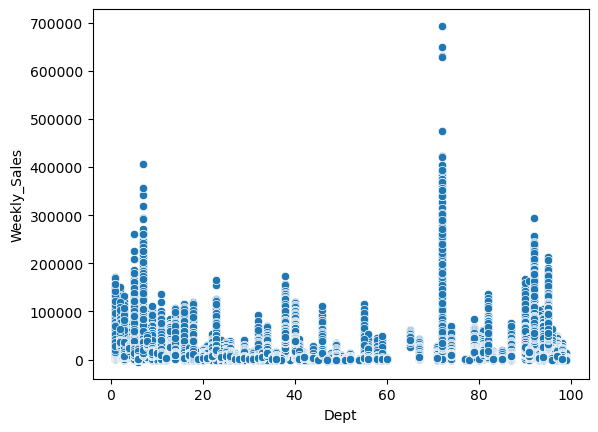

In [18]:
#Most of the data in the dataset is non holiday

sns.scatterplot(x="Dept", y="Weekly_Sales", data=df_train);

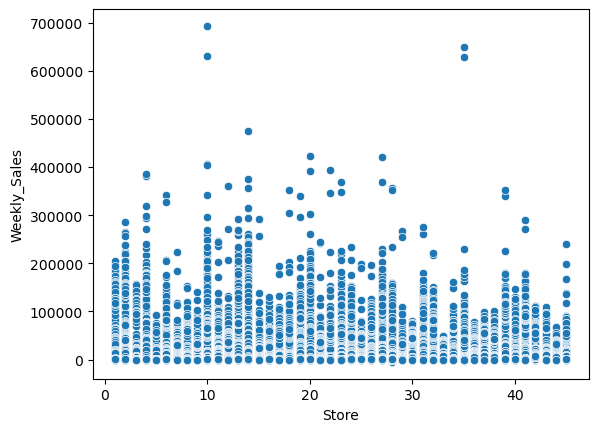

In [19]:
sns.scatterplot(x="Store",y="Weekly_Sales",data=df_train);

Conclusion:There seems to be non linear relationship between store,dept and weeekly sales variable

In [20]:
df_train.groupby("Dept")['Weekly_Sales'].mean()

Dept
1     19213.485088
2     43607.020113
3     11793.698516
4     25974.630238
5     21365.583515
          ...     
95    69824.423080
96    15210.942761
97    14255.576919
98     6824.694889
99      415.487065
Name: Weekly_Sales, Length: 81, dtype: float64

In [21]:
df_train.groupby("Store")["Weekly_Sales"].mean()

Store
1     21710.543621
2     26898.070031
3      6373.033983
4     29161.210415
5      5053.415813
6     21913.243624
7      8358.766148
8     13133.014768
9      8772.890379
10    26332.303819
11    19276.762751
12    14867.308619
13    27355.136891
14    28784.851727
15     9002.493073
16     7863.224124
17    12954.393636
18    15733.313136
19    20362.126734
20    29508.301592
21    11283.435496
22    15181.218886
23    19776.180881
24    18969.106500
25    10308.157810
26    14554.129672
27    24826.984536
28    18714.889803
29     8158.810609
30     8764.237719
31    19681.907464
32    16351.621855
33     5728.414053
34    13522.081671
35    13803.596986
36     8584.412563
37    10297.355026
38     7492.478460
39    21000.763562
40    13763.632803
41    17976.004648
42    11443.370118
43    13415.114118
44     6038.929814
45    11662.897315
Name: Weekly_Sales, dtype: float64

analysing the avg weekly sales of all the stores

In [22]:
df_train["Store"].value_counts()

13    10474
10    10315
4     10272
1     10244
2     10238
24    10228
27    10225
34    10224
20    10214
6     10211
32    10202
19    10148
31    10142
28    10113
41    10088
11    10062
23    10050
14    10040
40    10017
15     9901
8      9895
39     9878
17     9864
18     9859
26     9854
25     9804
7      9762
12     9705
22     9688
45     9637
21     9582
35     9528
29     9455
16     9443
3      9036
5      8999
9      8867
38     7362
37     7206
44     7169
30     7156
42     6953
43     6751
33     6487
36     6222
Name: Store, dtype: int64

Conclusion: Store 14 have max avg sales

In [23]:
#Correlation Analysis
df_train.corr()

,Store,Dept,Weekly_Sales,IsHoliday
Store,1.000000,0.024004,-0.085195,-0.000548
Dept,0.024004,1.000000,0.148032,0.000916
Weekly_Sales,-0.085195,0.148032,1.000000,0.012774
IsHoliday,-0.000548,0.000916,0.012774,1.000000


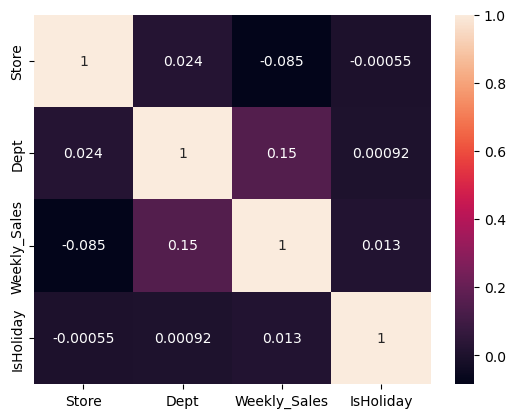

In [24]:
sns.heatmap(df_train.corr(), annot=True);

Conclusion:There seems to be Store and Dept not strongly Correlated with Weekly Sales

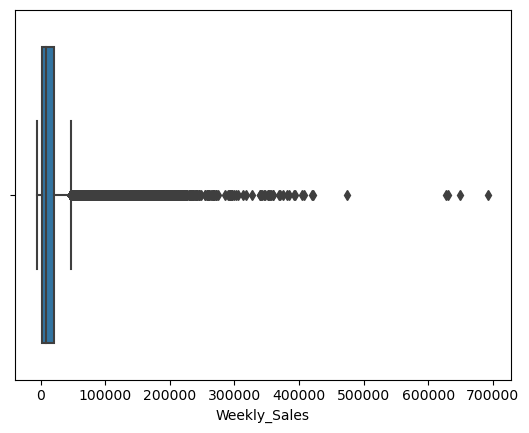

In [25]:
sns.boxplot(x="Weekly_Sales", data=df_train);

By inspection, the 'Date' datatype is an object, we need to change it to datetime

In [26]:
type(df_train['Date'])

pandas.core.series.Series

In [27]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 421570 entries, 0 to 421569
Data columns (total 5 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   Store         421570 non-null  int64  
 1   Dept          421570 non-null  int64  
 2   Date          421570 non-null  object 
 3   Weekly_Sales  421570 non-null  float64
 4   IsHoliday     421570 non-null  bool   
dtypes: bool(1), float64(1), int64(2), object(1)
memory usage: 13.3+ MB


In [28]:
df_store.head()

,Store,Type,Size
0,1,A,151315
1,2,A,202307
2,3,B,37392
3,4,A,205863
4,5,B,34875


In [29]:
df_feature.head()

,Store,Date,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,IsHoliday
0,1,2010-02-05,42.31,2.572,NaN,NaN,NaN,NaN,NaN,211.096358,8.106,False
1,1,2010-02-12,38.51,2.548,NaN,NaN,NaN,NaN,NaN,211.242170,8.106,True
2,1,2010-02-19,39.93,2.514,NaN,NaN,NaN,NaN,NaN,211.289143,8.106,False
3,1,2010-02-26,46.63,2.561,NaN,NaN,NaN,NaN,NaN,211.319643,8.106,False
4,1,2010-03-05,46.50,2.625,NaN,NaN,NaN,NaN,NaN,211.350143,8.106,False


In [33]:
#merge df_train, df_store, and df_feature
df_aux = df_train.merge(df_store, how='left', on='Store')
df_train = df_aux.merge(df_feature, how='left', on=('Store', 'Date', 'IsHoliday'))
df_train.head()

,Store,Dept,Date,Weekly_Sales,IsHoliday,Type,Size,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment
0,1,1,2010-02-05,24924.50,False,A,151315,42.31,2.572,NaN,NaN,NaN,NaN,NaN,211.096358,8.106
1,1,1,2010-02-12,46039.49,True,A,151315,38.51,2.548,NaN,NaN,NaN,NaN,NaN,211.242170,8.106
2,1,1,2010-02-19,41595.55,False,A,151315,39.93,2.514,NaN,NaN,NaN,NaN,NaN,211.289143,8.106
3,1,1,2010-02-26,19403.54,False,A,151315,46.63,2.561,NaN,NaN,NaN,NaN,NaN,211.319643,8.106
4,1,1,2010-03-05,21827.90,False,A,151315,46.50,2.625,NaN,NaN,NaN,NaN,NaN,211.350143,8.106


In [35]:
#using pandas profiling for analysis of df_t
df_train.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [36]:
# creating year, month, week and day columns
df_train['Date'] = pd.to_datetime(df_train['Date'])
df_train['Year'] = (df_train.Date.dt.year).astype(int)
df_train['Month'] = (df_train.Date.dt.month).astype(int)
df_train['Week'] = ((df_train.Date.dt.isocalendar().week)*1.0).astype(int)
df_train['Day'] = (df_train.Date.dt.day).astype(int)

In [37]:
# replacing the False and True values of the IsHoliday column with 0 and 1
df_train['IsHoliday'].replace({False: 0, True: 1}, inplace=True)

In [38]:
# adding columns for holidays
df_train['SuperBowl'] = df_train['Week'].apply(lambda x: 1 if x == 6 else 0)
df_train['LaborDay'] = df_train['Week'].apply(lambda x: 1 if x == 35 else 0)
df_train['Tranksgiving'] = df_train['Week'].apply(lambda x: 1 if x == 46 else 0)
df_train['Christmas'] = df_train['Week'].apply(lambda x: 1 if x == 51 else 0)
df_train["Tksgiving_to_Xmas"] = df_train['Week'].apply(lambda x: 1 if (x>46) & (x<52)  else 0)

In [39]:
# replacing the False and True values of the IsHoliday column with 0 and 1
df_train['IsHoliday'].replace({False: 0, True: 1}, inplace=True)

In [40]:
# adding columns for holidays
df_train['SuperBowl'] = df_train['Week'].apply(lambda x: 1 if x == 6 else 0)
df_train['LaborDay'] = df_train['Week'].apply(lambda x: 1 if x == 35 else 0)
df_train['Tranksgiving'] = df_train['Week'].apply(lambda x: 1 if x == 46 else 0)
df_train['Christmas'] = df_train['Week'].apply(lambda x: 1 if x == 51 else 0)
df_train["Tksgiving_to_Xmas"] = df_train['Week'].apply(lambda x: 1 if (x>46) & (x<52)  else 0)

In [41]:
# columns with predictor variables
# Markdown columns are mostly missing values, so we'll try to go without them initially.
predictors = ['IsHoliday', 'Month', 'Day', 'Temperature', 'Fuel_Price', 'CPI', 'Unemployment', 'SuperBowl', 'LaborDay', 'Tranksgiving', 'Christmas', 'Tksgiving_to_Xmas']

In [42]:
# X_train = predictor variables
# y_train = dependent variable
X_train = df_train[predictors]
y_train = df_train.Weekly_Sales

In [43]:
# This function runs GridSearch on the model to test all parameter options
def model(model, params, X, Y, cv = None):
    mod = model
    mod_grid = GridSearchCV(mod, params, cv = cv)
    mod_grid.fit(X, Y)
    
    return mod_grid, mod_grid.best_params_

In [44]:
# decision tree parameters
parameters = {'max_depth': [50,75,100,125],
                 'min_samples_split': [50,75,100,125],
                 'max_features': [0.5,0.75]}

# model DecisionTreeRegressor
model, best_params = model(DecisionTreeRegressor(), parameters, X_train, y_train, 10)
best_params # best parameters

{'max_depth': 75, 'max_features': 0.5, 'min_samples_split': 125}

In [45]:
# predict_sales column receives predicted weekly sales values
df_train["predict_sales"] = model.predict(df_train[predictors])

In [46]:
# auxiliary dataframes for comparing predicted values with real values
predicted_sales = df_train.groupby('Date')['predict_sales'].sum()
Weekly_Sales = df_train.groupby('Date')['Weekly_Sales'].sum()

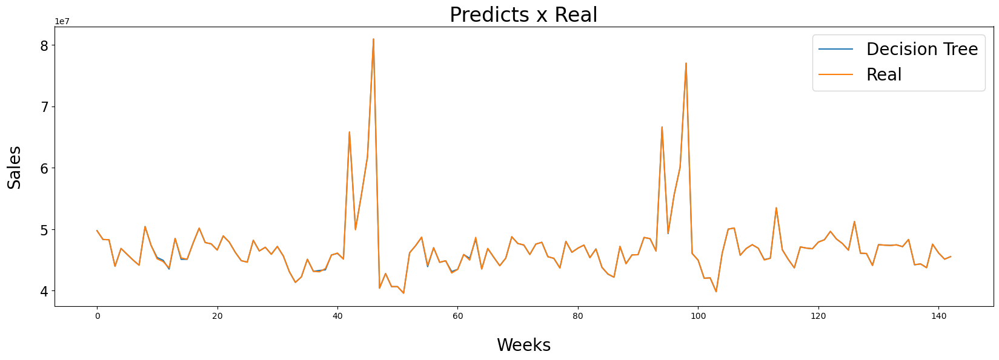

In [47]:
# plotting the comparison chart
plt.figure(figsize=(20,6))
plt.plot(predicted_sales.values)
plt.plot(Weekly_Sales.values)

plt.yticks( fontsize=16)
plt.ylabel('Sales', fontsize=20, labelpad=20)
plt.xlabel('Weeks', fontsize=20, labelpad=20)

plt.title("Predicts x Real", fontsize=24)
plt.legend(['Decision Tree', 'Real'], fontsize=20);

In [48]:
# this function calculates the quality metrics mae, rmse and wmae
def ml_error(df,y,pred,var_feriado):

    
    mae = mean_absolute_error(y, pred)
    rmse = np.sqrt(mean_squared_error(y, pred))  
    
    weights = df[var_feriado].apply(lambda x: 1 if x==1 else 5)
    wmae= np.round(np.sum(weights*abs(y-pred))/(np.sum(weights)), 2)
    
    return pd.DataFrame({'MAE' : mae,
                        'RMSE' : rmse,
                        'WMAE':wmae}, index = [0])

In [49]:
results = ml_error(X_train, y_train, df_train["predict_sales"], "IsHoliday")
results

,MAE,RMSE,WMAE
0,14305.801659,21712.205411,14240.37


adjusting test.csv apply the model

In [50]:
df_test.head()

,Store,Dept,Date,IsHoliday
0,1,1,2012-11-02,False
1,1,1,2012-11-09,False
2,1,1,2012-11-16,False
3,1,1,2012-11-23,True
4,1,1,2012-11-30,False


In [53]:
# merge test, store and feature
df_aux_test = df_test.merge(df_store, how='left', on='Store')
df_test = df_aux_test.merge(df_feature, how='left', on=('Store', 'Date', 'IsHoliday'))
df_test.head()

,Store,Dept,Date,IsHoliday,Type,Size,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment
0,1,1,2012-11-02,False,A,151315,55.32,3.386,6766.44,5147.70,50.82,3639.90,2737.42,223.462779,6.573
1,1,1,2012-11-09,False,A,151315,61.24,3.314,11421.32,3370.89,40.28,4646.79,6154.16,223.481307,6.573
2,1,1,2012-11-16,False,A,151315,52.92,3.252,9696.28,292.10,103.78,1133.15,6612.69,223.512911,6.573
3,1,1,2012-11-23,True,A,151315,56.23,3.211,883.59,4.17,74910.32,209.91,303.32,223.561947,6.573
4,1,1,2012-11-30,False,A,151315,52.34,3.207,2460.03,NaN,3838.35,150.57,6966.34,223.610984,6.573


In [54]:
# using pandas profiling for analysis of df
df_test.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [55]:
# creating year, month, week and day columns
df_test['Date'] = pd.to_datetime(df_test['Date'])
df_test['Year'] = (df_test.Date.dt.year).astype(int)
df_test['Month'] = (df_test.Date.dt.month).astype(int)
df_test['Week'] = ((df_test.Date.dt.isocalendar().week)*1.0).astype(int)
df_test['Day'] = (df_test.Date.dt.day).astype(int)

In [56]:
# adding columns for holidays
df_test['SuperBowl'] = df_test['Week'].apply(lambda x: 1 if x == 6 else 0)
df_test['LaborDay'] = df_test['Week'].apply(lambda x: 1 if x == 35 else 0)
df_test['Tranksgiving'] = df_test['Week'].apply(lambda x: 1 if x == 46 else 0)
df_test['Christmas'] = df_test['Week'].apply(lambda x: 1 if x == 51 else 0)
df_test["Tksgiving_to_Xmas"] = df_test['Week'].apply(lambda x: 1 if (x>46) & (x<52)  else 0)
df_test.head()

,Store,Dept,Date,IsHoliday,Type,Size,Temperature,Fuel_Price,MarkDown1,MarkDown2,...,Unemployment,Year,Month,Week,Day,SuperBowl,LaborDay,Tranksgiving,Christmas,Tksgiving_to_Xmas
0,1,1,2012-11-02,False,A,151315,55.32,3.386,6766.44,5147.70,...,6.573,2012,11,44,2,0,0,0,0,0
1,1,1,2012-11-09,False,A,151315,61.24,3.314,11421.32,3370.89,...,6.573,2012,11,45,9,0,0,0,0,0
2,1,1,2012-11-16,False,A,151315,52.92,3.252,9696.28,292.10,...,6.573,2012,11,46,16,0,0,1,0,0
3,1,1,2012-11-23,True,A,151315,56.23,3.211,883.59,4.17,...,6.573,2012,11,47,23,0,0,0,0,1
4,1,1,2012-11-30,False,A,151315,52.34,3.207,2460.03,NaN,...,6.573,2012,11,48,30,0,0,0,0,1


In [57]:
df_test.drop(columns=['MarkDown1', 'MarkDown2', 'MarkDown3', 'MarkDown4', 'MarkDown5'], inplace=True)

In [59]:
df_test.dropna(inplace=True)
df_test["predict_sales"] = model.predict(df_test[predictors])

In [60]:
predicts = df_test["predict_sales"]

id = df_test['Store'].apply(lambda x: str(x)+'_')+df_test['Dept'].apply(lambda x: str(x)+'_')+df_test['Date'].astype(str)

In [61]:
sample_submission = pd.concat([id,predicts],axis=1)
sample_submission

,0,predict_sales
0,1_1_2012-11-02,21891.513973
1,1_1_2012-11-09,21891.513973
2,1_1_2012-11-16,21891.513973
3,1_1_2012-11-23,30402.858784
4,1_1_2012-11-30,14086.250806
...,...,...
115046,45_98_2013-03-29,15598.514789
115047,45_98_2013-04-05,9451.594188
115048,45_98_2013-04-12,10955.932449
115049,45_98_2013-04-19,10955.932449


In [62]:
sample_submission.to_csv('submission.csv',index=False)

In [63]:
#let's check
sample_submission

,0,predict_sales
0,1_1_2012-11-02,21891.513973
1,1_1_2012-11-09,21891.513973
2,1_1_2012-11-16,21891.513973
3,1_1_2012-11-23,30402.858784
4,1_1_2012-11-30,14086.250806
...,...,...
115046,45_98_2013-03-29,15598.514789
115047,45_98_2013-04-05,9451.594188
115048,45_98_2013-04-12,10955.932449
115049,45_98_2013-04-19,10955.932449


THANK YOU